# Smoothing investigations

In [1]:
import numpy as np
import pandas as pd

import pywt

import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
match_data = pd.read_csv("match_data.csv")

In [3]:
sorted_match_data = match_data.sort_values(by=['participation_id', 'Time (s)'])

# Smoothing speed values

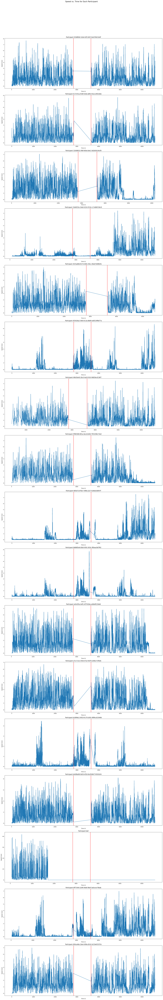

In [4]:
nrows = sorted_match_data['participation_id'].nunique()
ncols = 1

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 128)) 
fig.suptitle('Speed vs. Time for Each Participant', fontsize=16)

# Flatten axes array for easier iteration
axes = axes.flatten()

# Iterate through each participant, plotting data for each
for idx, participant in enumerate(sorted_match_data['participation_id'].unique()):

    participant_data = sorted_match_data[sorted_match_data['participation_id'] == participant]
    
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Speed (m/s)'])
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Speed (m/s)')

    ax.axvline(x=2850, color='Red')
    ax.axvline(x=3650, color='Red')

# Adjust layout to prevent overlap of subplots
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

plt.savefig("cleaning_visualisation/speed_over_90.pdf")
plt.show()

Lets look at a snapshot of the data so we can see what sort of noise we're dealing with

In [5]:
data_snapshot = sorted_match_data[(60 < sorted_match_data["Time (s)"]) & (sorted_match_data["Time (s)"] < 120)]

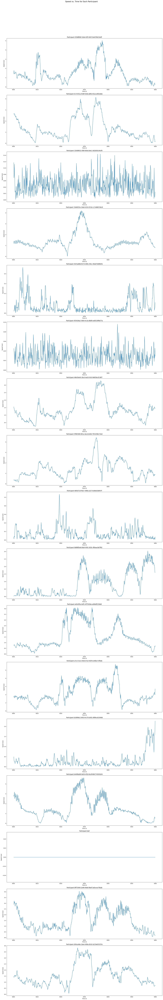

In [32]:
nrows = sorted_match_data['participation_id'].nunique()
ncols = 1

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 128))
fig.suptitle('Speed vs. Time for Each Participant', fontsize=16)

axes = axes.flatten()

for idx, participant in enumerate(data_snapshot['participation_id'].unique()):

    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Speed (m/s)'])
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Speed (m/s)')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  

plt.savefig("cleaning_visualisation/speed_snapshot.pdf")
plt.show()

Okay so some of these are clearly more noisy than others but there seems to be a lot of noise.

### Median filter + EMA

Lets have a go using a median filter followed by an exponential moving average.

/var/folders/5b/kfhm4mss6sjdr7rf8618rz1w0000gq/T/ipykernel_2714/4093828956.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  participant_data['Speed_median_filtered'] = participant_data['Speed (m/s)'].rolling(window=window_size, center=True).median()
/var/folders/5b/kfhm4mss6sjdr7rf8618rz1w0000gq/T/ipykernel_2714/4093828956.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  participant_data['Smoothed Speed (m/s)'] = participant_data['Speed_median_filtered'].ewm(alpha=alpha).mean()
/var/folders/5b/kfhm4

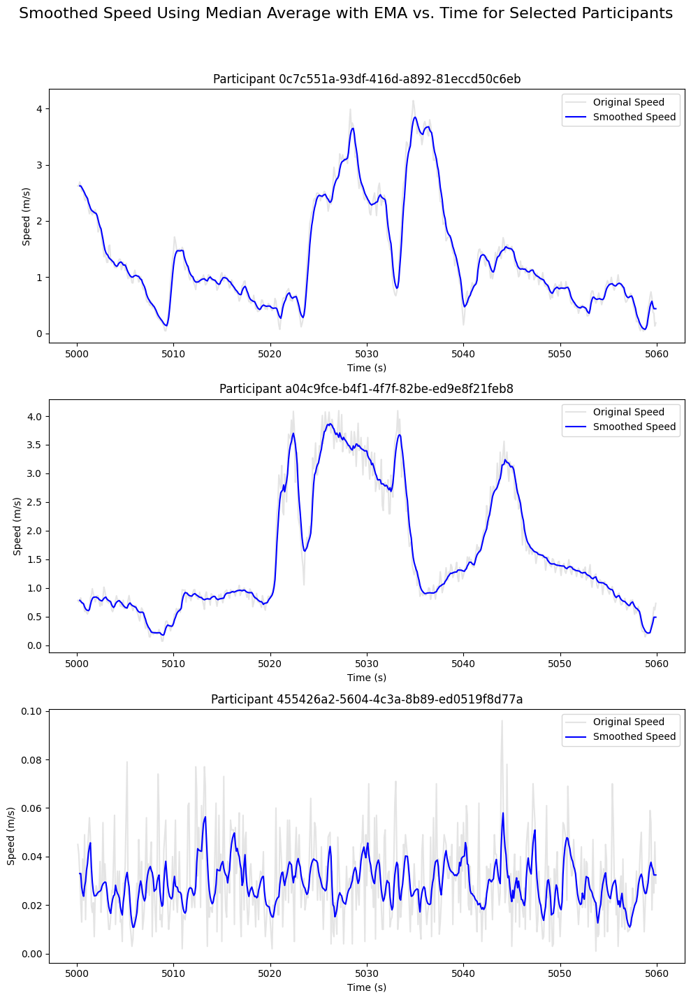

In [33]:
participants = ["0c7c551a-93df-416d-a892-81eccd50c6eb",
                "a04c9fce-b4f1-4f7f-82be-ed9e8f21feb8",
                "455426a2-5604-4c3a-8b89-ed0519f8d77a"]

nrows = 3
ncols = 1

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, 15))
fig.suptitle('Smoothed Speed Using Median Average with EMA vs. Time for Selected Participants', fontsize=16)

for idx, participant in enumerate(participants):
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    
    # Apply a median filter
    window_size = 5
    participant_data['Speed_median_filtered'] = participant_data['Speed (m/s)'].rolling(window=window_size, center=True).median()

    # Apply an exponential moving average to the median-filtered data
    alpha = 0.4
    participant_data['Smoothed Speed (m/s)'] = participant_data['Speed_median_filtered'].ewm(alpha=alpha).mean()
    
    # Plot original and smoothed speed data
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Speed (m/s)'], label='Original Speed', color='lightgray', alpha=0.6)
    ax.plot(participant_data['Time (s)'], participant_data['Smoothed Speed (m/s)'], label='Smoothed Speed', color='blue')
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Speed (m/s)')
    ax.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95])

plt.savefig("cleaning_visualisation/speed_snapshot_median_ema_smoothed.pdf")
plt.show()


Okay that seems like a reasonable level of smoothing.

Let's try some other methods

### Fourier Analysis

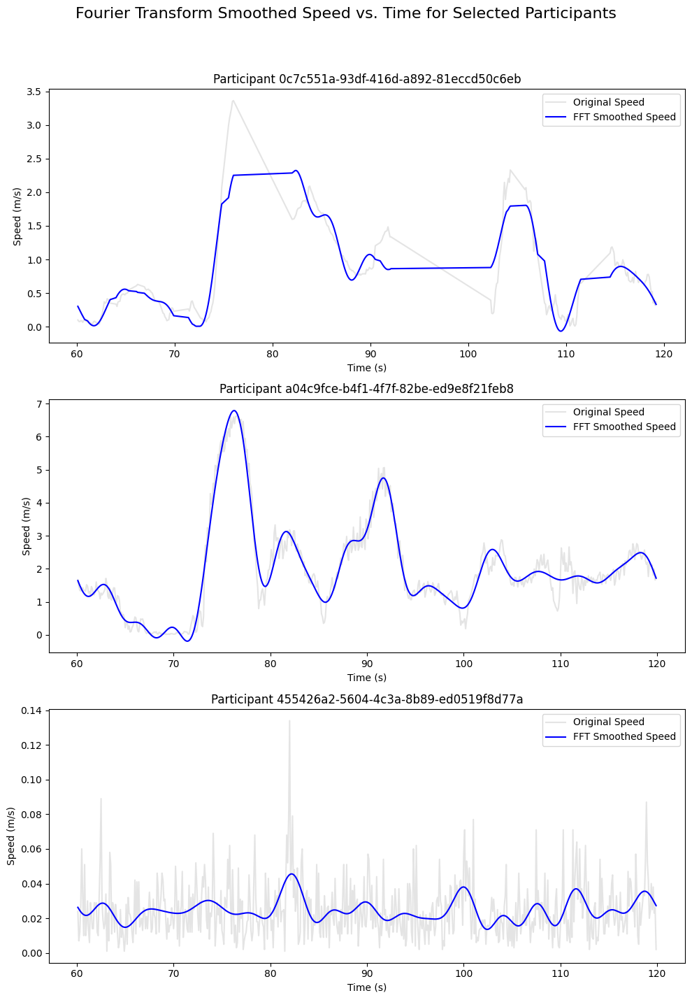

In [8]:
participants = ["0c7c551a-93df-416d-a892-81eccd50c6eb",
                "a04c9fce-b4f1-4f7f-82be-ed9e8f21feb8",
                "455426a2-5604-4c3a-8b89-ed0519f8d77a"]

nrows = 3
ncols = 1

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, 15))
fig.suptitle('Fourier Transform Smoothed Speed vs. Time for Selected Participants', fontsize=16)

for idx, participant in enumerate(participants):
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    
    # Apply Fourier Transform
    fft_result = np.fft.fft(participant_data['Speed (m/s)'])
    frequencies = np.fft.fftfreq(len(fft_result), d=(participant_data['Time (s)'].iloc[1] - participant_data['Time (s)'].iloc[0]))
    
    # Low-pass filter: zero out frequencies above a certain threshold
    threshold_frequency = 0.3
    fft_result[(np.abs(frequencies) > threshold_frequency)] = 0
    
    # Inverse FFT to transform back to time domain
    smoothed_speed = np.fft.ifft(fft_result)
    
    # Plot original and smoothed speed data
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Speed (m/s)'], label='Original Speed', color='lightgray', alpha=0.6)
    ax.plot(participant_data['Time (s)'], np.real(smoothed_speed), label='FFT Smoothed Speed', color='blue')
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Speed (m/s)')
    ax.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.savefig("cleaning_visualisation/speed_snapshot_fourier.pdf")
plt.show()

We Can see that this works amazingly for very nosy data, However for data that is not so noisy, and especially data missing time stamps there are some issues.

Kalman filter requires a complex human movement model to compare to the sensor data which seems out of the scope with this task. That being said it certainly could do a brilliant job were it to be implemented.


### Wavelet Transformation

lets have a go at a wavelet transformation

In [9]:
print(pywt.wavelist())

['bior1.1', 'bior1.3', 'bior1.5', 'bior2.2', 'bior2.4', 'bior2.6', 'bior2.8', 'bior3.1', 'bior3.3', 'bior3.5', 'bior3.7', 'bior3.9', 'bior4.4', 'bior5.5', 'bior6.8', 'cgau1', 'cgau2', 'cgau3', 'cgau4', 'cgau5', 'cgau6', 'cgau7', 'cgau8', 'cmor', 'coif1', 'coif2', 'coif3', 'coif4', 'coif5', 'coif6', 'coif7', 'coif8', 'coif9', 'coif10', 'coif11', 'coif12', 'coif13', 'coif14', 'coif15', 'coif16', 'coif17', 'db1', 'db2', 'db3', 'db4', 'db5', 'db6', 'db7', 'db8', 'db9', 'db10', 'db11', 'db12', 'db13', 'db14', 'db15', 'db16', 'db17', 'db18', 'db19', 'db20', 'db21', 'db22', 'db23', 'db24', 'db25', 'db26', 'db27', 'db28', 'db29', 'db30', 'db31', 'db32', 'db33', 'db34', 'db35', 'db36', 'db37', 'db38', 'dmey', 'fbsp', 'gaus1', 'gaus2', 'gaus3', 'gaus4', 'gaus5', 'gaus6', 'gaus7', 'gaus8', 'haar', 'mexh', 'morl', 'rbio1.1', 'rbio1.3', 'rbio1.5', 'rbio2.2', 'rbio2.4', 'rbio2.6', 'rbio2.8', 'rbio3.1', 'rbio3.3', 'rbio3.5', 'rbio3.7', 'rbio3.9', 'rbio4.4', 'rbio5.5', 'rbio6.8', 'shan', 'sym2', 'sym3

In [10]:
def wavelet_smoothing(data, wavelet_name='db4'):
    coeffs = pywt.wavedec(data, wavelet_name, mode='per')
    sigma = np.std(coeffs[-1])
    uthresh = sigma * np.sqrt(2 * np.log(len(data)))
    coeffs = [pywt.threshold(i, value=uthresh, mode='soft') for i in coeffs]
    smoothed_data = pywt.waverec(coeffs, wavelet_name, mode='per')
    
    # Handle potential length issues
    if len(smoothed_data) > len(data):
        smoothed_data = smoothed_data[:len(data)]  # Trim if longer
    elif len(smoothed_data) < len(data):
        # Pad if shorter
        smoothed_data = np.pad(smoothed_data, (0, len(data) - len(smoothed_data)), 'edge')
    
    return smoothed_data

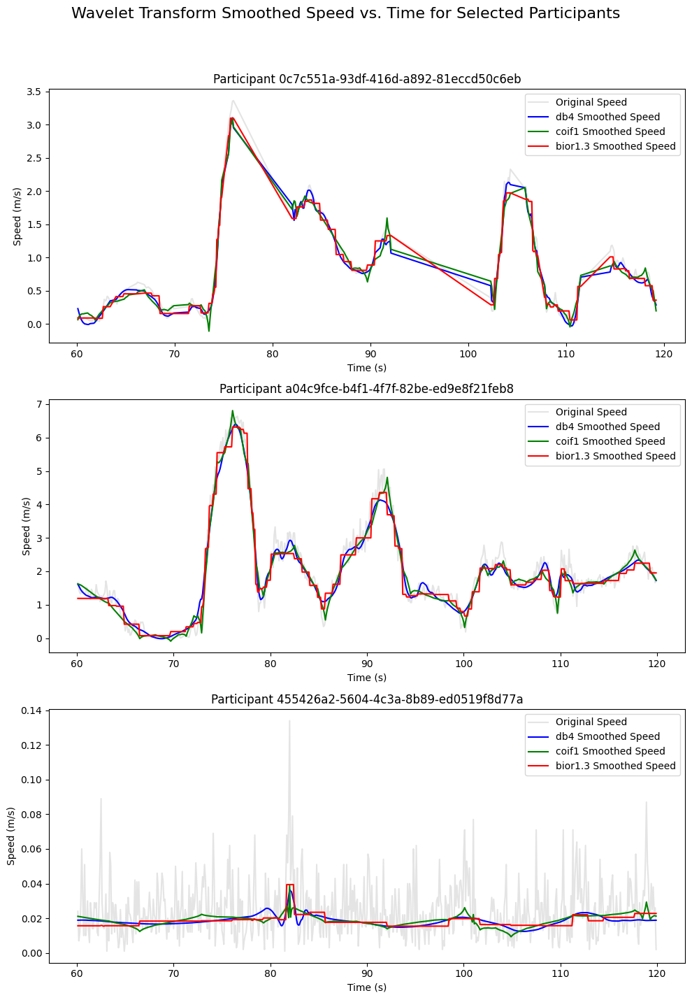

In [11]:
participants = ["0c7c551a-93df-416d-a892-81eccd50c6eb",
                "a04c9fce-b4f1-4f7f-82be-ed9e8f21feb8",
                "455426a2-5604-4c3a-8b89-ed0519f8d77a"]

wavelets = ['db4', 'coif1', 'bior1.3']
colors = ['blue', 'green', 'red']

nrows = len(participants)
ncols = 1
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, 15))
fig.suptitle('Wavelet Transform Smoothed Speed vs. Time for Selected Participants', fontsize=16)

# Iterate through each paricipant, applying wavelet transform for each
for idx, participant in enumerate(participants):
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Speed (m/s)'], label='Original Speed', color='lightgray', alpha=0.6)
    
        # Apply wavelet transform with each different wavelet
    for wavelet, color in zip(wavelets, colors):
        smoothed_speed = wavelet_smoothing(participant_data['Speed (m/s)'], wavelet)
        ax.plot(participant_data['Time (s)'], smoothed_speed, label=f'{wavelet} Smoothed Speed', color=color)

    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Speed (m/s)')
    ax.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.savefig("cleaning_visualisation/speed_snapshot_wavelet_smoothed.pdf")
plt.show()

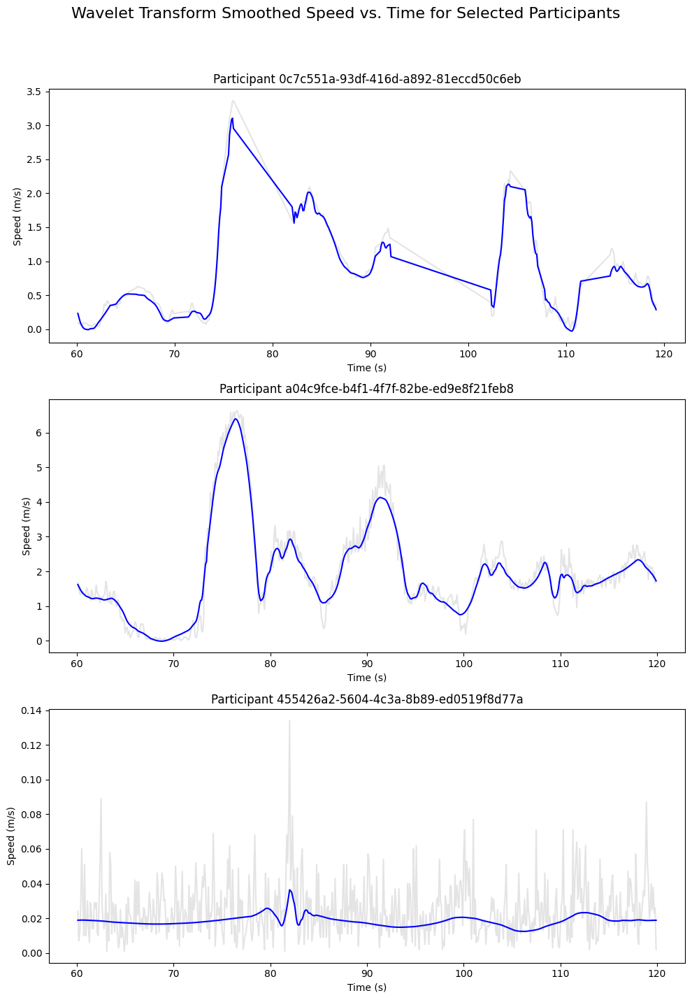

In [12]:
participants = ["0c7c551a-93df-416d-a892-81eccd50c6eb",
                "a04c9fce-b4f1-4f7f-82be-ed9e8f21feb8",
                "455426a2-5604-4c3a-8b89-ed0519f8d77a"]

wavelets = ['db4']
colors = ['blue', 'green', 'red']

nrows = len(participants)
ncols = 1
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, 15))
fig.suptitle('Wavelet Transform Smoothed Speed vs. Time for Selected Participants', fontsize=16)

# Iterate through each participant, applying wavelet transform
for idx, participant in enumerate(participants):
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Speed (m/s)'], label='Original Speed', color='lightgray', alpha=0.6)
    
    for wavelet, color in zip(wavelets, colors):
        smoothed_speed = wavelet_smoothing(participant_data['Speed (m/s)'], wavelet)
        ax.plot(participant_data['Time (s)'], smoothed_speed, label=f'{wavelet} Smoothed Speed', color=color)

    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Speed (m/s)')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.savefig("cleaning_visualisation/speed_snapshot_wavelet_smoothed.pdf")
plt.show()

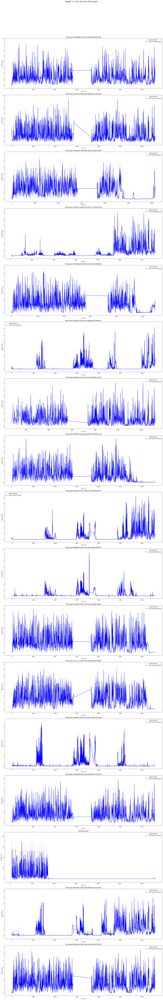

In [13]:
nrows = sorted_match_data['participation_id'].nunique()
ncols = 1
wavelet = 'db4'

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 128))
fig.suptitle('Speed vs. Time for Each Participant', fontsize=16)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate through each participant
for idx, participant in enumerate(sorted_match_data['participation_id'].unique()):
    # Filter the data for the current participant
    participant_data = sorted_match_data[sorted_match_data['participation_id'] == participant]
    
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Speed (m/s)'], label='Original Speed', color='lightgray', alpha=0.6)
    
    smoothed_speed = wavelet_smoothing(participant_data['Speed (m/s)'], wavelet)
    ax.plot(participant_data['Time (s)'], smoothed_speed, label=f'{wavelet} Smoothed Speed', color=color)
    
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Speed (m/s)')
    ax.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95])

plt.savefig("cleaning_visualisation/speed_over_90_wavelet_smoothed.pdf")
plt.show()

At least from a glance, db4 seems to provide very good smoothing across the board, without losing too much of the overall data, so lets go with that.

# Positioning smoothing

## Pitch x

<function matplotlib.pyplot.show(close=None, block=None)>

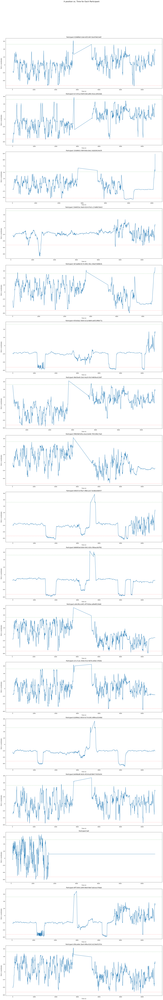

In [14]:
nrows = sorted_match_data['participation_id'].nunique()
ncols = 1

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 128))
fig.suptitle('X position vs. Time for Each Participant', fontsize=16)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate through each participant
for idx, participant in enumerate(sorted_match_data['participation_id'].unique()):
    # Filter the data for the current participant
    participant_data = sorted_match_data[sorted_match_data['participation_id'] == participant]
    
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_x'])
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Pitch x coordinates')

    ax.axhline(y=-52.5, color='red', linestyle='--', linewidth=0.75, alpha=0.7)  # Adding a line at y = -34
    ax.axhline(y=52.5, color='green', linestyle='--', linewidth=0.75, alpha=0.7)  # Adding a line at y = 34


plt.tight_layout(rect=[0, 0.03, 1, 0.95])  

plt.savefig("cleaning_visualisation/x_coord_over_90.pdf")
plt.show

In [15]:
data_snapshot = sorted_match_data[(5000 < sorted_match_data["Time (s)"]) & (sorted_match_data["Time (s)"] < 5060)]

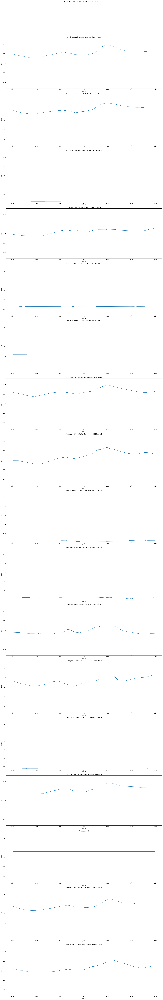

In [16]:
nrows = sorted_match_data['participation_id'].nunique()
ncols = 1

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 128))
fig.suptitle('Position x vs. Time for Each Participant', fontsize=16)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate through each participant
for idx, participant in enumerate(data_snapshot['participation_id'].unique()):
    # Filter the data for the current participant
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_x'])
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Pitch x')

    # Dynamically set the x-axis limits based on the data
    min_x = min(participant_data['Pitch_x'].min(), -52.5)
    max_x = max(participant_data['Pitch_x'].max(), 52.5)
    ax.set_ylim([min_x, max_x])


plt.tight_layout(rect=[0, 0.03, 1, 0.95]) 

plt.savefig("cleaning_visualisation/pitch_x_snapshot.pdf")
plt.show()

Okay so the positional data does not seem nearly as noisy, but lets do some smoothing on it anyway, as the lack of noise for this snapshot does not mean it doesn't exist elsewhere in the data.

### Median Transform + EMA

/var/folders/5b/kfhm4mss6sjdr7rf8618rz1w0000gq/T/ipykernel_2714/203148303.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  participant_data['pos_x_median_filtered'] = participant_data['Pitch_x'].rolling(window=window_size, center=True).median()
/var/folders/5b/kfhm4mss6sjdr7rf8618rz1w0000gq/T/ipykernel_2714/203148303.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  participant_data['Smoothed pitch_x'] = participant_data['pos_x_median_filtered'].ewm(alpha=alpha).mean()
/var/folders/5b/kfhm4mss6sjdr7r

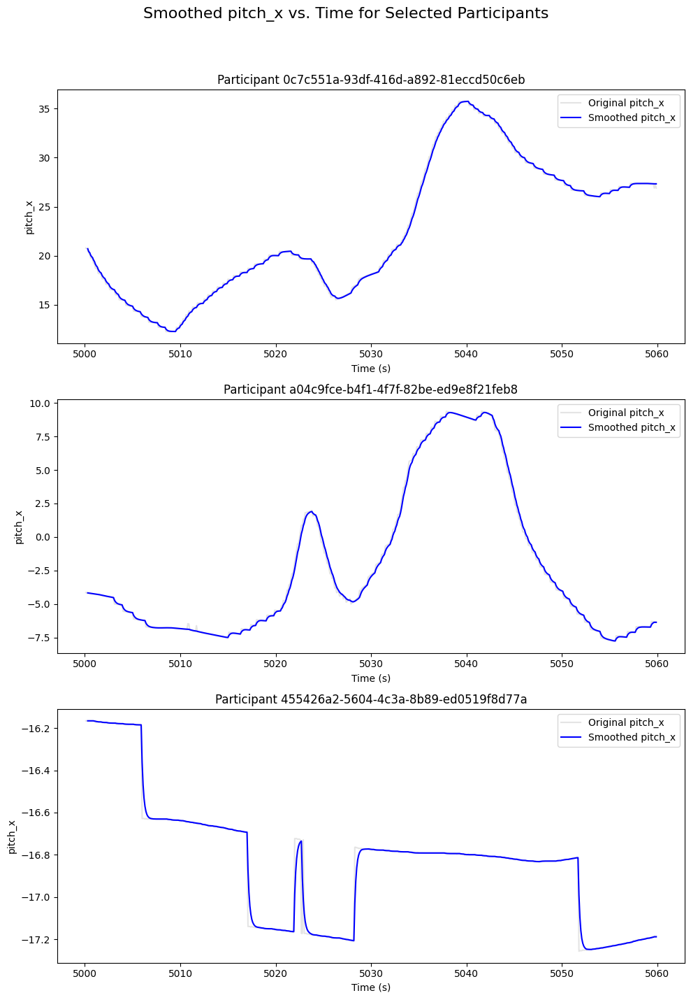

In [17]:
participants = ["0c7c551a-93df-416d-a892-81eccd50c6eb",
                "a04c9fce-b4f1-4f7f-82be-ed9e8f21feb8",
                "455426a2-5604-4c3a-8b89-ed0519f8d77a"]

nrows = 3
ncols = 1

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, 15))
fig.suptitle('Smoothed pitch_x vs. Time for Selected Participants', fontsize=16)

for idx, participant in enumerate(participants):
    # Filter data for the current participant
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    
    # Apply a median filter
    window_size = 5  # Window size for the median filter
    participant_data['pos_x_median_filtered'] = participant_data['Pitch_x'].rolling(window=window_size, center=True).median()

    # Apply an exponential moving average to the median-filtered data
    alpha = 0.4  # Smoothing factor for EMA
    participant_data['Smoothed pitch_x'] = participant_data['pos_x_median_filtered'].ewm(alpha=alpha).mean()
    
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_x'], label='Original pitch_x', color='lightgray', alpha=0.6)
    ax.plot(participant_data['Time (s)'], participant_data['Smoothed pitch_x'], label='Smoothed pitch_x', color='blue')
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('pitch_x')
    ax.legend()


plt.savefig("cleaning_visualisation/pitch_x_snapshot_median_ema_smoothed.pdf")
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


Great, this does not seem to be having much of a negative impact on the non-noisy data.

Let's inspect some other cleaning methods.

### Fourier Transformation

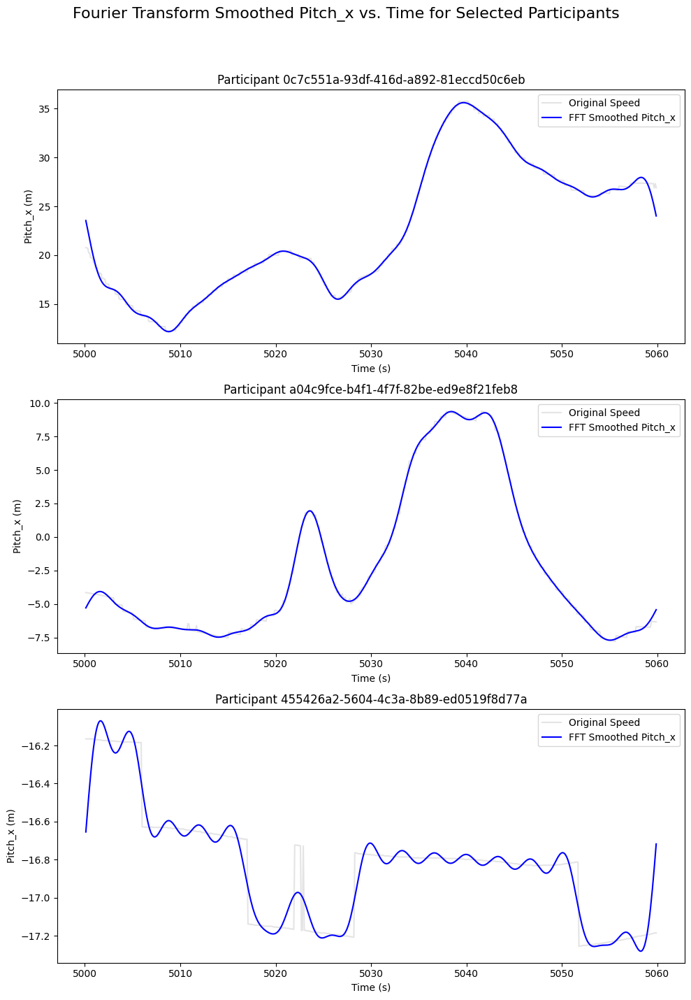

In [18]:
participants = ["0c7c551a-93df-416d-a892-81eccd50c6eb",
                "a04c9fce-b4f1-4f7f-82be-ed9e8f21feb8",
                "455426a2-5604-4c3a-8b89-ed0519f8d77a"]

nrows = 3
ncols = 1 

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, 15))
fig.suptitle('Fourier Transform Smoothed Pitch_x vs. Time for Selected Participants', fontsize=16)

for idx, participant in enumerate(participants):
    # Filter data for the current participant
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    
    # Apply Fourier Transform for smoothing
    # FFT of the speed data
    fft_result = np.fft.fft(participant_data['Pitch_x'])
    frequencies = np.fft.fftfreq(len(fft_result), d=(participant_data['Time (s)'].iloc[1] - participant_data['Time (s)'].iloc[0]))
    
    # Low-pass filter: zero out frequencies above a certain threshold
    threshold_frequency = 0.3
    fft_result[(np.abs(frequencies) > threshold_frequency)] = 0
    
    # Inverse FFT to transform back to time domain
    smoothed_pitch_x = np.fft.ifft(fft_result)
    
    # Plot original and smoothed speed data
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_x'], label='Original Speed', color='lightgray', alpha=0.6)
    ax.plot(participant_data['Time (s)'], np.real(smoothed_pitch_x), label='FFT Smoothed Pitch_x', color='blue')
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Pitch_x (m)')
    ax.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.savefig("cleaning_visualisation/pitch_x_snapshot_fourier.pdf")
plt.show()

Clearly we can see that particularly for the final participant, this is having some issues when applied to a low-noise dataset.

### Wavelet transfomation

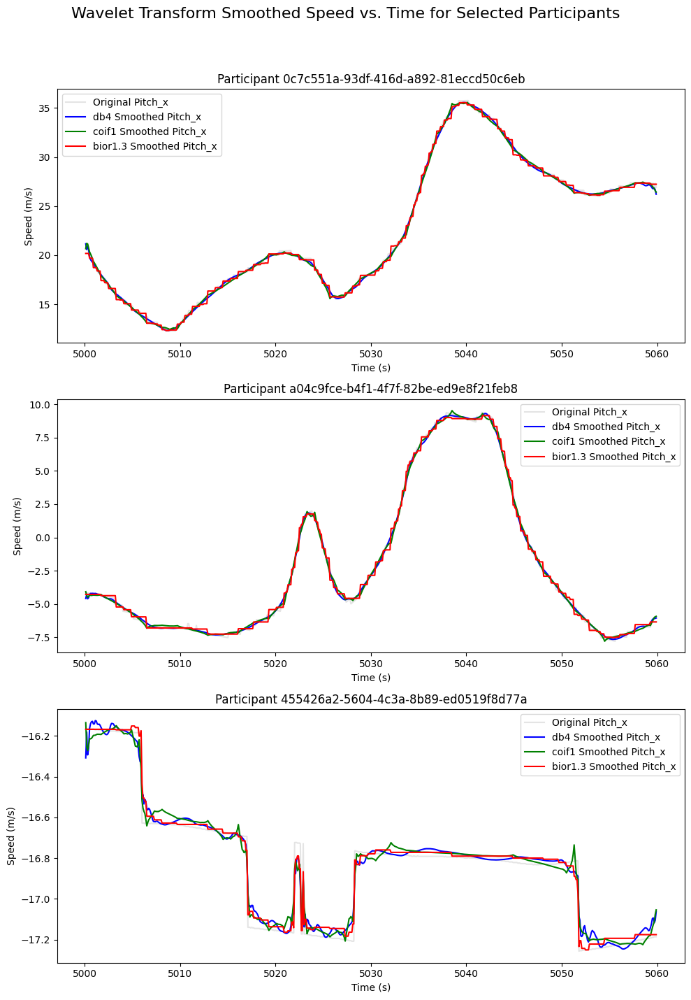

In [19]:
participants = ["0c7c551a-93df-416d-a892-81eccd50c6eb",
                "a04c9fce-b4f1-4f7f-82be-ed9e8f21feb8",
                "455426a2-5604-4c3a-8b89-ed0519f8d77a"]

wavelets = ['db4', 'coif1', 'bior1.3']
colors = ['blue', 'green', 'red']

nrows = len(participants)
ncols = 1
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, 15))
fig.suptitle('Wavelet Transform Smoothed Speed vs. Time for Selected Participants', fontsize=16)

for idx, participant in enumerate(participants):
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_x'], label='Original Pitch_x', color='lightgray', alpha=0.6)
    
    for wavelet, color in zip(wavelets, colors):
        smoothed_pitch_x = wavelet_smoothing(participant_data['Pitch_x'], wavelet)
        ax.plot(participant_data['Time (s)'], smoothed_pitch_x, label=f'{wavelet} Smoothed Pitch_x', color=color)

    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Speed (m/s)')
    ax.legend()
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.savefig("cleaning_visualisation/pitch_x_snapshot_wavelet_smoothed.pdf")
plt.show()

It's very close here, but db4 seems to be doing a fairly good job accross the baord here again.

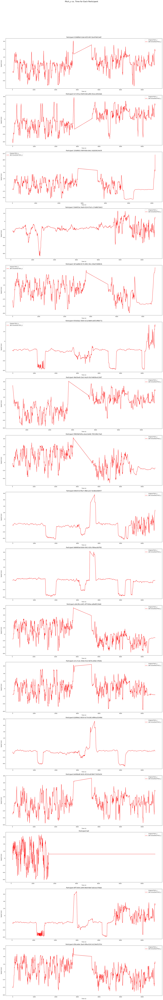

In [20]:
nrows = sorted_match_data['participation_id'].nunique()
ncols = 1
wavelet = 'db4'

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 128))
fig.suptitle('Pitch_x vs. Time for Each Participant', fontsize=16)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate through each unique participant in the dataset
for idx, participant in enumerate(sorted_match_data['participation_id'].unique()):
    # Filter the data for the current participant
    participant_data = sorted_match_data[sorted_match_data['participation_id'] == participant]
    
    # Plot speed vs time on the respective subplot
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_x'], label='Original Pitch_x', color='lightgray', alpha=0.6)
    
    smoothed_pitch_x = wavelet_smoothing(participant_data['Pitch_x'], wavelet)
    ax.plot(participant_data['Time (s)'], smoothed_pitch_x, label=f'{wavelet} Smoothed Pitch_x', color=color)
    
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Speed (m/s)')
    ax.legend()


plt.tight_layout(rect=[0, 0.03, 1, 0.95])


plt.savefig("cleaning_visualisation/pitch_x_over_90_wavelet_smoothed.pdf")
plt.show()

Okay perfect, at the large scale we don't seem to be losing too much data here.

Let's go ahead and do the same thing for pitch_y here, but I think it is suitable to just look at a db4 wavelet transformation.

## Pitch y

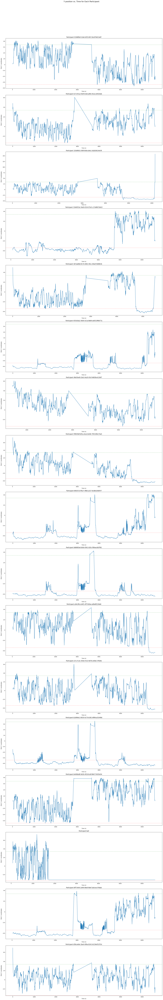

In [21]:
nrows = sorted_match_data['participation_id'].nunique()
ncols = 1

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 128))
fig.suptitle('Y position vs. Time for Each Participant', fontsize=16)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate through each participant
for idx, participant in enumerate(sorted_match_data['participation_id'].unique()):
    # Filter the data for the current participant
    participant_data = sorted_match_data[sorted_match_data['participation_id'] == participant]
    
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_y'])
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Pitch Y coordinates')

    ax.axhline(y=-34, color='red', linestyle='--', linewidth=0.75, alpha=0.7)  # Adding a line at y = -34
    ax.axhline(y=34, color='green', linestyle='--', linewidth=0.75, alpha=0.7)  # Adding a line at y = 34

plt.tight_layout(rect=[0, 0.03, 1, 0.95]) 
plt.savefig("cleaning_visualisation/pitch_y_over_90.pdf")
plt.show()

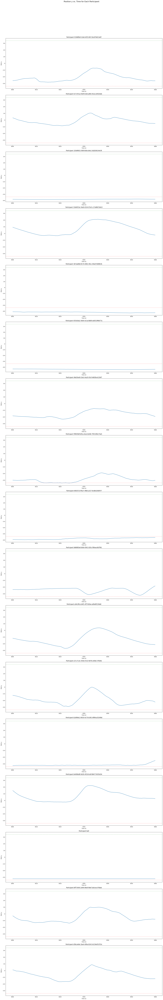

In [22]:
nrows = sorted_match_data['participation_id'].nunique()
ncols = 1

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 128))
fig.suptitle('Position y vs. Time for Each Participant', fontsize=16)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate through each unique participant in the dataset
for idx, participant in enumerate(data_snapshot['participation_id'].unique()):
    # Filter the data for the current participant
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_y'])
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Pitch y')

    ax.axhline(y=-34, color='red', linestyle='--', linewidth=0.75, alpha=0.7)  # Adding a line at y = -34
    ax.axhline(y=34, color='green', linestyle='--', linewidth=0.75, alpha=0.7)  # Adding a line at y = 34


plt.tight_layout(rect=[0, 0.03, 1, 0.95])  

plt.savefig("cleaning_visualisation/pitch_y_snapshot.pdf")
plt.show()

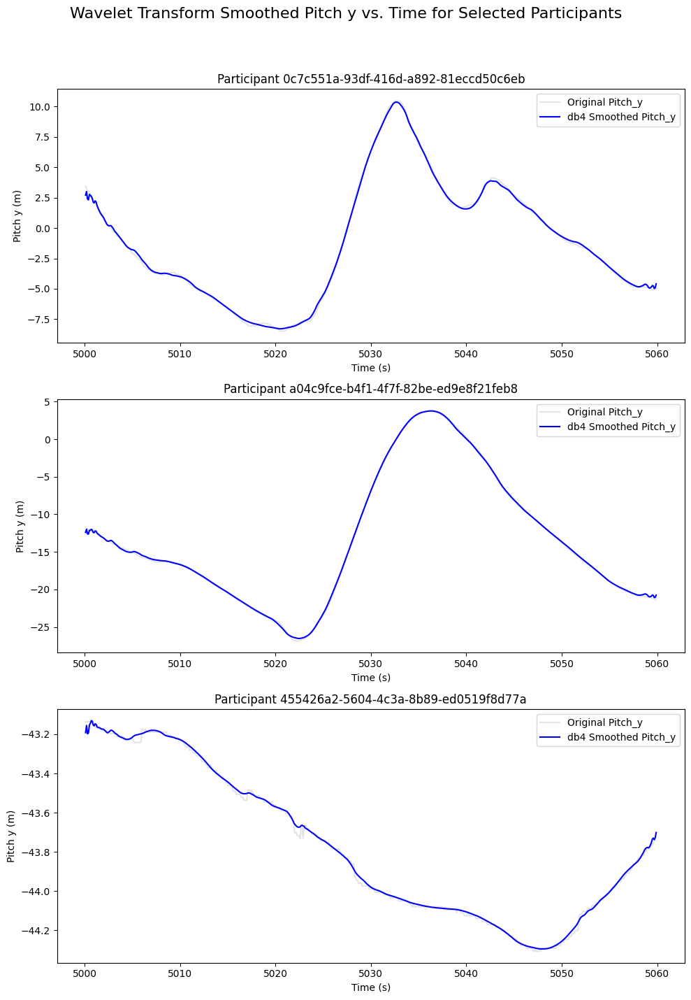

In [23]:
participants = ["0c7c551a-93df-416d-a892-81eccd50c6eb",
                "a04c9fce-b4f1-4f7f-82be-ed9e8f21feb8",
                "455426a2-5604-4c3a-8b89-ed0519f8d77a"]

wavelets = ['db4']
colors = ['blue']

nrows = len(participants)
ncols = 1
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, 15))
fig.suptitle('Wavelet Transform Smoothed Pitch y vs. Time for Selected Participants', fontsize=16)

for idx, participant in enumerate(participants):
    participant_data = data_snapshot[data_snapshot['participation_id'] == participant]
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_y'], label='Original Pitch_y', color='lightgray', alpha=0.6)
    
    for wavelet, color in zip(wavelets, colors):
        smoothed_pitch_y = wavelet_smoothing(participant_data['Pitch_y'], wavelet)
        ax.plot(participant_data['Time (s)'], smoothed_pitch_y, label=f'{wavelet} Smoothed Pitch_y', color=color)

    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Pitch y (m)')
    ax.legend()


plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.savefig("cleaning_visualisation/pitch_y_snapshot_wavelet_smoothed.pdf")
plt.show()

Great, Once again a db4 wavelet transformation seems to keep the shape well while reducing little bits of noise.

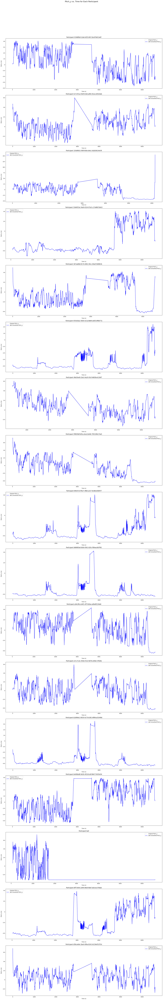

In [24]:
nrows = sorted_match_data['participation_id'].nunique()
ncols = 1
wavelet = 'db4'

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 128))
fig.suptitle('Pitch_y vs. Time for Each Participant', fontsize=16)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate through each unique participant in the dataset
for idx, participant in enumerate(sorted_match_data['participation_id'].unique()):
    # Filter the data for the current participant
    participant_data = sorted_match_data[sorted_match_data['participation_id'] == participant]
    
    # Plot speed vs time on the respective subplot
    ax = axes[idx]
    ax.plot(participant_data['Time (s)'], participant_data['Pitch_y'], label='Original Pitch_y', color='lightgray', alpha=0.6)
    
    smoothed_pitch_y = wavelet_smoothing(participant_data['Pitch_y'], wavelet)
    ax.plot(participant_data['Time (s)'], smoothed_pitch_y, label=f'{wavelet} Smoothed Pitch_y', color=color)
    
    ax.set_title(f'Participant {participant}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Pitch y (m)')
    ax.legend()

plt.tight_layout(rect=[0, 0.03, 1, 0.95]) 
plt.savefig("cleaning_visualisation/pitch_y_over_90_wavelet_smoothed.pdf")
plt.show()

Great. Lets use db4 wavelet transformations over the whole course of the data. We can then remove any points still remaining outside the limits of human movement that may have not been caught, just in case.

## Looking at the ball

In [25]:
ball_data = sorted_match_data[sorted_match_data["participation_id"] == 'ball']

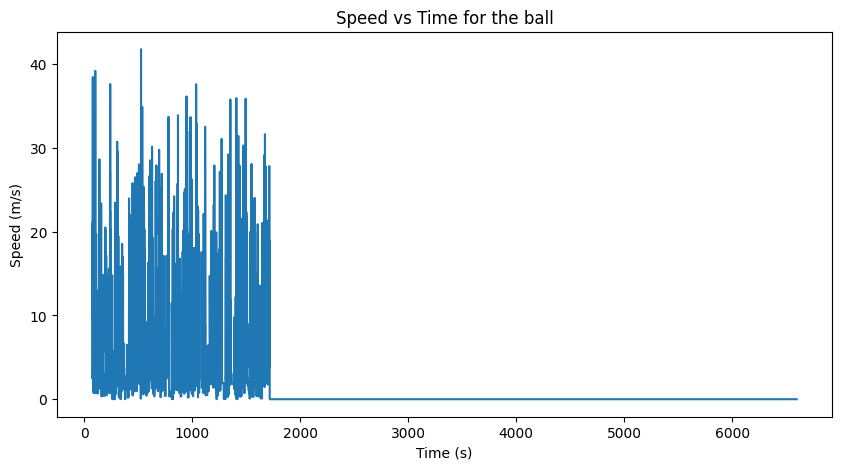

In [26]:

plt.figure(figsize=(10, 5))
plt.plot(ball_data['Time (s)'], ball_data['Speed (m/s)']) 

plt.title('Speed vs Time for the ball')
plt.xlabel('Time (s)')
plt.ylabel('Speed (m/s)')

plt.show()

In [27]:
ball_data = ball_data[ball_data['Time (s)'] < 1730]

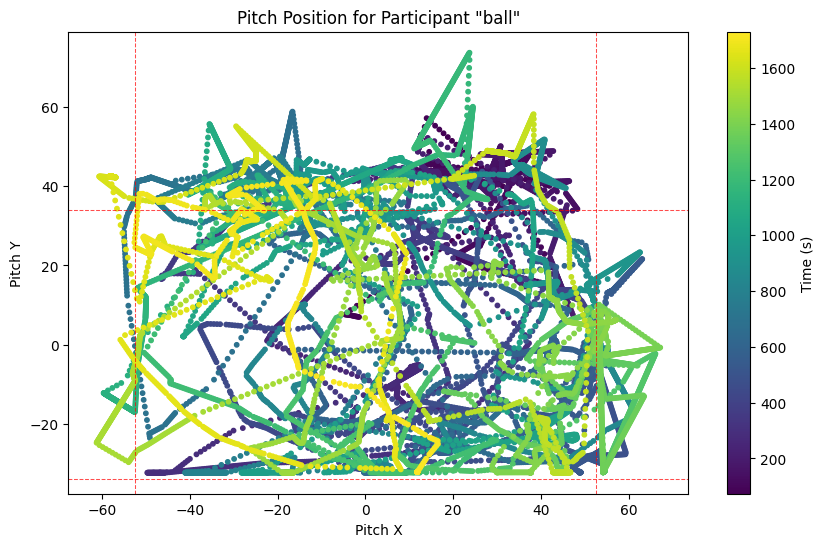

In [28]:
# Create a scatter plot of Pitch_x vs Pitch_y for the ball
plt.figure(figsize=(10, 6))
plt.scatter(ball_data['Pitch_x'], ball_data['Pitch_y'], c=ball_data['Time (s)'], cmap='viridis', s=10)
plt.colorbar(label='Time (s)')  # Add colour bar to show time progression

plt.title('Pitch Position for Participant "ball"')
plt.xlabel('Pitch X')
plt.ylabel('Pitch Y')

plt.axhline(y=-34, color='red', linestyle='--', linewidth=0.75, alpha=0.7)
plt.axhline(y=34, color='red', linestyle='--', linewidth=0.75, alpha=0.7) 

plt.axvline(x=-52.5, color='red', linestyle='--', linewidth=0.75, alpha=0.7)
plt.axvline(x=52.5, color='red', linestyle='--', linewidth=0.75, alpha=0.7)

plt.show()

/var/folders/5b/kfhm4mss6sjdr7rf8618rz1w0000gq/T/ipykernel_2714/1839420981.py:3: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  ax = sns.kdeplot(


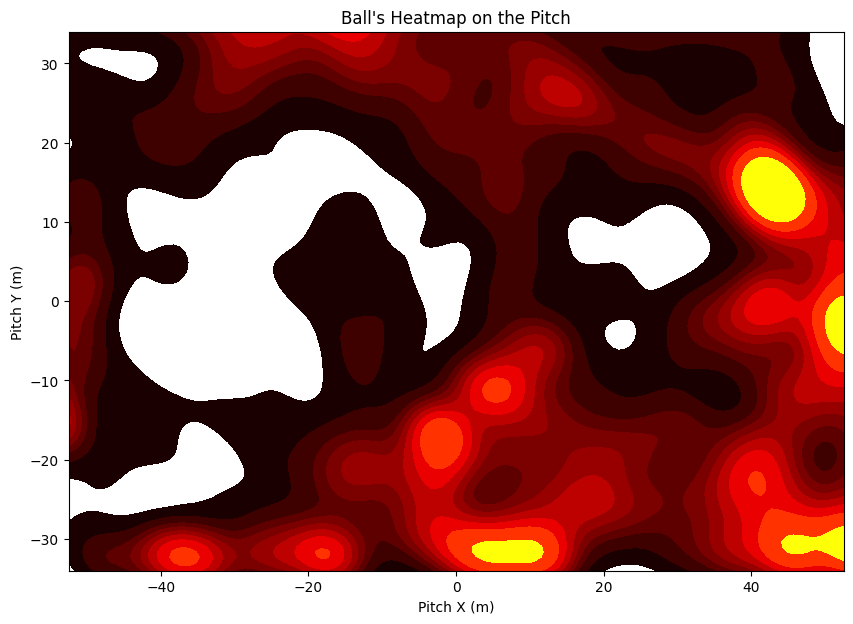

In [29]:
plt.figure(figsize=(10, 7)) 

ax = sns.kdeplot(
    x=ball_data['Pitch_x'], 
    y=ball_data['Pitch_y'], 
    cmap="hot",
    shade=True,
    bw_adjust=0.5
)

ax.set_xlim(-52.5, 52.5)
ax.set_ylim(-34, 34)

plt.title('Ball\'s Heatmap on the Pitch')
plt.xlabel('Pitch X (m)')
plt.ylabel('Pitch Y (m)')
plt.show()

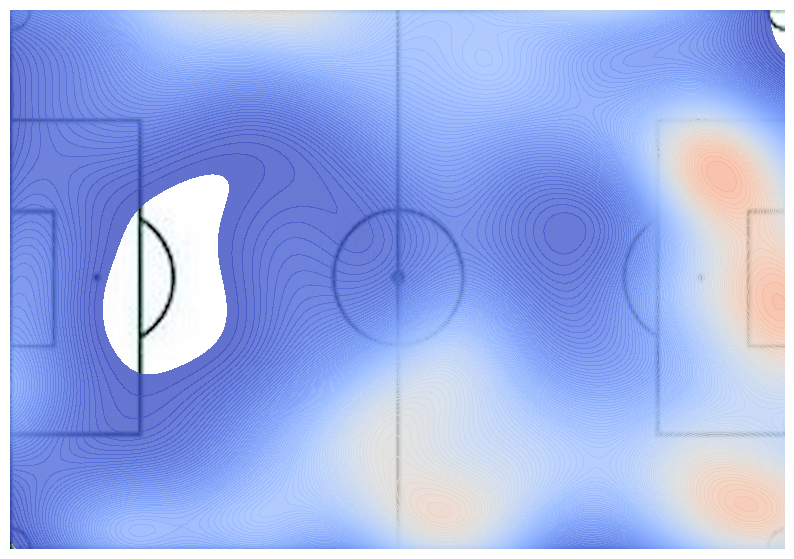

In [30]:
from PIL import Image
Image.MAX_IMAGE_PIXELS = None

pitch_image = Image.open('image.jpeg')

fig, ax = plt.subplots(figsize=(10, 7))

# Plot the pitch image as background
extent = [-52.5, 52.5, -34, 34]
ax.imshow(pitch_image, extent=extent, aspect='auto')

sns.kdeplot(
    x=ball_data['Pitch_x'], 
    y=ball_data['Pitch_y'], 
    cmap="coolwarm",
    fill=True,  # Fill the contours
    alpha=0.8,  # Transparancy of the heatmap over picture
    levels=100,  # Number of contour levels
    ax=ax
)

# Remove axes
ax.set_xlim(extent[0], extent[1])
ax.set_ylim(extent[2], extent[3])
ax.axis('off') 

plt.show()
